# 1.1 Generative AI models

Generative AI models combine various AI algorithms to represent and process content. For example, to generate text, various natural language processing techniques transform raw characters (e.g., letters, punctuation and words) into sentences, parts of speech, entities and actions, which are represented as vectors using multiple encoding techniques. Similarly, images are transformed into various visual elements, also expressed as vectors. One caution is that these techniques can also encode the biases, racism, deception and puffery contained in the training data.

Once developers settle on a way to represent the world, they apply a particular neural network to generate new content in response to a query or prompt. Techniques such as GANs and variational autoencoders (VAEs) -- neural networks with a decoder and encoder -- are suitable for generating realistic human faces, synthetic data for AI training or even facsimiles of particular humans.

Recent progress in transformers such as Google's Bidirectional Encoder Representations from Transformers (BERT), OpenAI's GPT and Google AlphaFold have also resulted in neural networks that can not only encode language, images and proteins but also generate new content.

## 1.2 Generative AI Use cases

Generative AI can be applied in various use cases to generate virtually any kind of content. The technology is becoming more accessible to users of all kinds thanks to cutting-edge breakthroughs like GPT that can be tuned for different applications. Some of the use cases for generative AI include the following:

* Implementing chatbots for customer service and technical support.
* Deploying deepfakes for mimicking people or even specific individuals.
* Improving dubbing for movies and educational content in different languages.
* Writing email responses, dating profiles, resumes and term papers.
* Creating photorealistic art in a particular style.
* Improving product demonstration videos.
* Suggesting new drug compounds to test.
* Designing physical products and buildings.
* Optimizing new chip designs.
* Writing music in a specific style or tone.

### 1.3 What are some examples of generative AI tools?
Generative AI tools exist for various modalities, such as text, imagery, music, code and voices. Some popular AI content generators to explore include the following:

* Text generation tools include GPT, Jasper, AI-Writer and Lex.
* Image generation tools include Dall-E 2, Midjourney and Stable Diffusion.
* Music generation tools include Amper, Dadabots and MuseNet.
* Code generation tools include CodeStarter, Codex, GitHub Copilot and Tabnine.
* Voice synthesis tools include Descript, Listnr and Podcast.ai.
* AI chip design tool companies include Synopsys, Cadence, Google and Nvidia.

### 1.4 Theoretical underpinnings of Disffusion models

#### Focus Point: Diffusion Models
#### Considerations: Midjourney, StableDiffusion, Dall-E
#### Leverage: ChatGPT
    
    
### Diffusion Models:

Diffusion models are inspired by non-equilibrium thermodynamics. They define a Markov chain of diffusion steps to slowly add random noise to data and then learn to reverse the diffusion process to construct desired data samples from the noise. Unlike VAE or flow models, diffusion models are learned with a fixed procedure and the latent variable has high dimensionality (same as the original data).


<img src="https://lilianweng.github.io/posts/2021-07-11-diffusion-models/generative-overview.png" />
    


More specifically, a Diffusion Model is a latent variable model which maps to the latent space using a fixed Markov chain. This chain gradually adds noise to the data in order to obtain the approximate posterior 
, where 
 are the latent variables with the same dimensionality as 
. In the figure below, we see such a Markov chain manifested for image data.

<img src="notebook-images/1.png">

Ultimately, the image is asymptotically transformed to pure Gaussian noise. The goal of training a diffusion model is to learn the reverse process. By traversing backwards along this chain, we can generate new data.

<img src="notebook-images/2.png">

Beyond cutting-edge image quality, Diffusion Models come with a host of other benefits, including not requiring adversarial training. The difficulties of adversarial training are well-documented; and, in cases where non-adversarial alternatives exist with comparable performance and training efficiency, it is usually best to utilize them. On the topic of training efficiency, Diffusion Models also have the added benefits of scalability and parallelizability.

While Diffusion Models almost seem to be producing results out of thin air, there are a lot of careful and interesting mathematical choices and details that provide the foundation for these results, and best practices are still evolving in the literature. Let's take a look at the mathematical theory underpinning Diffusion Models in more detail now.

Diffusion Models - A Deep Dive
As mentioned above, a Diffusion Model consists of a forward process (or diffusion process), in which a datum (generally an image) is progressively noised, and a reverse process (or reverse diffusion process), in which noise is transformed back into a sample from the target distribution.

The sampling chain transitions in the forward process can be set to conditional Gaussians when the noise level is sufficiently low. Combining this fact with the Markov assumption leads to a simple parameterization of the forward process:

<img src="notebook-images/4.png">

nearly an isotropic Gaussian for sufficiently large T.

<img src="notebook-images/5.png">

Given the Markov assumption, the joint distribution of the latent variables is the product of the Gaussian conditional chain transitions (modified from source)

As mentioned previously, the "magic" of diffusion models comes in the reverse process. During training, the model learns to reverse this diffusion process in order to generate new data. Starting with the pure Gaussian noise 
, the model learns the joint distribution as
<img src="notebook-images/6.png">
where the time-dependent parameters of the Gaussian transitions are learned. Note in particular that the Markov formulation asserts that a given reverse diffusion transition distribution depends only on the previous timestep (or following timestep, depending on how you look at it):
<img src="notebook-images/7.png">

<img src="notebook-images/8.png">


Training
A Diffusion Model is trained by finding the reverse Markov transitions that maximize the likelihood of the training data. In practice, training equivalently consists of minimizing the variational upper bound on the negative log likelihood.
<img src="notebook-images/9.png">

Lvlb is technically an upper bound (the negative of the ELBO) which we are trying to minimize

We seek to rewrite the Lvlb in terms of Kullback-Leibler (KL) Divergences. The KL Divergence is an asymmetric statistical distance measure of how much one probability distribution P differs from a reference distribution Q. We are interested in formulating Lvlb in terms of KL divergences because the transition distributions in our Markov chain are Gaussians, and the KL divergence between Gaussians has a closed form.

What is the KL Divergence?
The mathematical form of the KL divergence for continuous distributions is

<img src="notebook-images/10.png">

Below you can see the KL divergence of a varying distribution P (blue) from a reference distribution Q (red). The green curve indicates the function within the integral in the definition for the KL divergence above, and the total area under the curve represents the value of the KL divergence of P from Q at any given moment, a value which is also displayed numerically.  

<img src="notebook-images/11.png">

Conditioning the forward process posterior results in a tractable form that leads to all KL divergences being comparisons between Gaussians. This means that the divergences can be exactly calculated with closed-form expressions rather than with Monte Carlo estimates.

Model Choices

With the mathematical foundation for our objective function established, we now need to make several choices regarding how our Diffusion Model will be implemented. For the forward process, the only choice required is defining the variance schedule, the values of which are generally increasing during the forward process.

For the reverse process, we much choose the Gaussian distribution parameterization / model architecture(s). Note the high degree of flexibility that Diffusion Models afford - the only requirement on our architecture is that its input and output have the same dimensionality.

The training and sampling algorithms for our Diffusion Model therefore can be succinctly captured in the below figure:

<img src="notebook-images/12.png">

Diffusion Model Theory Summary:

Birds-eye perspective:

* Our Diffusion Model is parameterized as a Markov chain, meaning that our latent variables  depend only on the previous (or following) timestep.

* The transition distributions in the Markov chain are Gaussian, where the forward process requires a variance schedule, and the reverse process parameters are learned.

* The diffusion process ensures that xT is asymptotically distributed as an isotropic Gaussian for sufficiently large T.

* In our case, the variance schedule was fixed, but it can be learned as well. For fixed schedules, following a geometric progression may afford better results than a linear progression. In either case, the variances are generally increasing with time in the series

* Diffusion Models are highly flexible and allow for any architecture whose input and output dimensionality are the same to be used. Many implementations use U-Net-like architectures.

* The training objective is to maximize the likelihood of the training data. This is manifested as tuning the model parameters to minimize the variational upper bound of the negative log likelihood of the data.

* Almost all terms in the objective function can be cast as KL Divergences as a result of our Markov assumption. These values become tenable to calculate given that we are using Gaussians, therefore omitting the need to perform Monte Carlo approximation.

* Ultimately, using a simplified training objective to train a function which predicts the noise component of a given latent variable yields the best and most stable results.

* A discrete decoder is used to obtain log likelihoods across pixel values as the last step in the reverse diffusion process.

## 2.  Data Generation

### Theme: Interior Decor

### Motive: Re-generate ideas (using AI) from masterminds and check the accuracy.

* Some visuals, we have a natural inclination to and more often than not, we have a tendancy not to be able to describe them for multiple reasons ( lack of knowledge, not enough depth in understanding a certain domain ). Why not use AI in assisting us to understand what we see. 

Steps Followed: 

* Collected instagram pictures (ideas) from some of the team's highly admired interior design profiles.


* Although midjourney does not have a python api, we found a third party api tool (https://userapi.ai/), that helped us send api requests. Some of the limitations through this approach still remained ( ratelimit ). We tried multiple requests with a time gap of 60s, which helped overcome the ratelimit.


* Generated prompts that were used subsequently to re-create,  from the /describe protocol ( image to text conversion )


* With the help of these generated prompts, we analyzed and evaluated how accurately midjourney was creating decor styles, in comparison to the original style, by re-creating an image from the prompt ( text to image conversion ).


* Additionally, we have tried image to image conversion, which obviously gave the most accurate results, for a general idea.


* Focus point - create prompts that created realistic decor ideas/styles. ( ideas very close to our imagination )


* How is this different from image to image conversion?


         *  Image to image conversion was clearly more accurate for this use case, but we wanted to generate prompts in addition to similar ideas, to be able to add-on and improvise from the generated prompts.

         * Although, a new interfior decor idea would have been generated from imgToimg conversion, we wanted to textually understand the underlying idea/style that was built from the original.

* Background:


        * We asked chatgpt for a base of interior decor styles as a starter, and below are the results, which seemed very generic. And we didn't want to create generic decor styles ( sub-styles: minimalistic/contemporary , when tried with these prompts, ai generates some generic stuff. We wanted a personalized touch, and didnt know how to describe our thoughts/ideas. And hence, we used pictures which better demonstreated our ideas ).
        
<img src="notebook-images/gpt-interior-style-ideas-base.png">
        
        * These prompts generated from image to text conversion from midjourney serve as a starter to generating better more customized prompts, and can be fine tuned based on our interests.
     

### Pipeline:

1. Collect images from instagram desired interior portfolio designs
         1.1. Sample 30 images ( most appropriate) 
2. Send ImgtoText (/describe) api requests to midjourney via https://userapi.ai/, for each of the sampled images
2. Store the responses
4. Run a bash script that reads api request results from the api dashbopard, and stores them in result{i}.json for each page in the dashboard.
<img src="notebook-images/userapi-results-dashboard.png">
<img src="notebook-images/userapi-dashboard-json.png">
5. Each response generates 4 results. Pre-process the data to randomly pick one of the 4 results for each prompt response
6. Wrtie the generated prompts to our original data file, to read the prompts later
7. For each of the prompt responses stores, send TexttoImg (/imagine) api requests to midjourney.
8. View, analyze and Compare the results. 
9. Try a simple TexttoImg generation using StableDiffusion. (ran a basic one, need more parameter tuning trials)
10. Generate 5 similar or better descriptions for each of the prompts generated, using chatgpt.
11. Evaluate the results using chatgpt generated prompts.

In [2]:
# import instaloader to download images from the profiles interested
# ??ig.post_metadata_txt_pattern
import instaloader

In [4]:
#Let's download pictures from profile of interest, and store them
profiles = ['aanaistudio', 'volume_zero', 'one.interior.mag', 'bajaestudio', 'lisaspollock', 'apartamentomagazine',]
ig = instaloader.Instaloader()
ig.download_profile('aanaistudio', profile_pic_only = False)

#Download all profiles of interest:
for p in profiles:
    ig.download_profile(p, profile_pic_only = False)

aanaistudio/2019-08-14_04-20-24_UTC_profile_pic.jpg already exists
Retrieving posts from profile aanaistudio.
Resuming from aanaistudio/iterator_BLjTQ0Ey.json.xz.
[ 12/581] aanaistudio/2023-10-05_02-52-38_UTC.jpg exists [The Praana Residence: Dining …] unchanged json 
[ 13/581] aanaistudio/2023-10-03_01-47-49_UTC.jpg [The Praana Residence: Dining …] json 
[ 14/581] aanaistudio/2023-09-30_04-30-49_UTC.jpg [The Praana Residence: Living …] json 
[ 15/581] aanaistudio/2023-09-29_03-24-19_UTC.jpg [The Praana Residence: Living …] json 
[ 16/581] aanaistudio/2023-09-27_04-19-49_UTC.jpg [The Praana Residence: Living …] json 
[ 17/581] aanaistudio/2023-09-26_02-40-58_UTC.jpg [The Praana Residence: Living …] json 
[ 18/581] aanaistudio/2023-09-19_02-41-36_UTC_1.jpg aanaistudio/2023-09-19_02-41-36_UTC_2.jpg aanaistudio/2023-09-19_02-41-36_UTC_3.jpg [The Praana Residence: Foyer  …] json 
[ 19/581] aanaistudio/2023-09-14_02-14-58_UTC.jpg [The Praana Residence: Foyer  …] json 
[ 20/581] aanaistudio/

[167/581] aanaistudio/2022-09-19_11-06-11_UTC_1.jpg aanaistudio/2022-09-19_11-06-11_UTC_2.jpg aanaistudio/2022-09-19_11-06-11_UTC_3.jpg aanaistudio/2022-09-19_11-06-11_UTC_4.jpg aanaistudio/2022-09-19_11-06-11_UTC_5.jpg aanaistudio/2022-09-19_11-06-11_UTC_6.jpg aanaistudio/2022-09-19_11-06-11_UTC_7.jpg aanaistudio/2022-09-19_11-06-11_UTC_8.jpg [Under the Rain Tree as publis…] json 
[168/581] aanaistudio/2022-09-16_02-20-53_UTC.jpg [Under The Rain Tree: A studio…] json 
[169/581] aanaistudio/2022-09-15_11-26-40_UTC.jpg [Then and now!   #transformati…] aanaistudio/2022-09-15_11-26-40_UTC.mp4 json 
[170/581] aanaistudio/2022-09-14_03-19-03_UTC_1.jpg aanaistudio/2022-09-14_03-19-03_UTC_2.jpg [Under The Raintree: The upsta…] json 
[171/581] aanaistudio/2022-09-14_03-11-47_UTC.jpg [Studio transformation! What a…] aanaistudio/2022-09-14_03-11-47_UTC.mp4 json 
[172/581] aanaistudio/2022-09-08_06-48-01_UTC.jpg [A very happy Onam from Team A…] aanaistudio/2022-09-08_06-48-01_UTC.mp4 json 
[173/5

[334/581] aanaistudio/2020-11-24_12-58-38_UTC.jpg [The Bedroom Edit by @hummingt…] json 
[335/581] aanaistudio/2020-11-21_04-02-43_UTC_1.jpg aanaistudio/2020-11-21_04-02-43_UTC_2.jpg aanaistudio/2020-11-21_04-02-43_UTC_3.jpg [The Soirée Collection: Master…] json 
[336/581] aanaistudio/2020-11-18_03-35-25_UTC_1.jpg aanaistudio/2020-11-18_03-35-25_UTC_2.jpg aanaistudio/2020-11-18_03-35-25_UTC_3.jpg aanaistudio/2020-11-18_03-35-25_UTC_4.jpg [The Soiree Collection: Master…] json 
[337/581] aanaistudio/2020-11-11_02-08-19_UTC_1.jpg aanaistudio/2020-11-11_02-08-19_UTC_2.jpg [The Soirée Collection: Living…] json 
[338/581] aanaistudio/2020-11-06_02-51-10_UTC_1.jpg aanaistudio/2020-11-06_02-51-10_UTC_2.jpg [The Soirée Collection: Dining…] json 
[339/581] aanaistudio/2020-11-04_02-49-11_UTC_1.jpg aanaistudio/2020-11-04_02-49-11_UTC_2.jpg [The Soirée collection: Living…] json 
[340/581] aanaistudio/2020-11-03_02-22-37_UTC.jpg [The Soirée Collection: Bedroo…] json 
[341/581] aanaistudio/2020-11-0

[490/581] aanaistudio/2019-08-16_04-21-47_UTC_1.jpg aanaistudio/2019-08-16_04-21-47_UTC_2.jpg aanaistudio/2019-08-16_04-21-47_UTC_3.jpg aanaistudio/2019-08-16_04-21-47_UTC_4.jpg aanaistudio/2019-08-16_04-21-47_UTC_5.jpg aanaistudio/2019-08-16_04-21-47_UTC_6.jpg aanaistudio/2019-08-16_04-21-47_UTC_7.jpg aanaistudio/2019-08-16_04-21-47_UTC_8.jpg aanaistudio/2019-08-16_04-21-47_UTC_9.jpg aanaistudio/2019-08-16_04-21-47_UTC_10.jpg [Sofa therapy for the weekend!…] json 
[491/581] aanaistudio/2019-08-14_04-06-37_UTC.jpg [It has been a little over a y…] json 
[492/581] aanaistudio/2019-08-12_04-05-04_UTC.jpg [Say no to Monday blues. Pick …] json 
[493/581] aanaistudio/2019-08-08_04-30-08_UTC.jpg [The Ebony Collection: Console…] json 
[494/581] aanaistudio/2019-08-05_03-26-29_UTC.jpg [Look at the stars, Look how t…] json 
[495/581] aanaistudio/2019-08-01_12-41-24_UTC.jpg [Client diaries: Lounge chair …] json 
[496/581] aanaistudio/2019-07-29_04-55-30_UTC.jpg [Handcrafted with love, this b…] js

In [52]:
import requests
import urllib
import urllib.request
import math
import time
from pathlib import Path
import os
import requests
import pandas as pd
import json
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
from PIL import Image 
from io import BytesIO

In [30]:
img_path = '/home/sumana/code/adv-data-science-info7390/assignment-creating-data/data'

In [152]:
#Stored a sample of 30 images to create and re-generate prompts from. Loading the data
path = '/home/sumana/Downloads/midjourney-img-links - Sheet1.csv'
insta_profile_img_data = pd.read_csv(path)

In [65]:
insta_profile_img_data

,profile,img_path,webhook_url
0,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/ephemeral-attachm...
1,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
2,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
3,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
4,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
5,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
6,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
7,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
8,apartmentomagazine,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...
9,apartmentomagazine,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...


In [153]:
#Setting all api endpoints for describe and imagine prompts along with the headers to be sent to the discord server, through tha api
midjourney_api_endpoint = 'https://api.userapi.ai'
imagine_post = '/midjourney/v2/imagine'
describe_post = '/midjourney/v2/describe'
headers = { "api-key": "c3f68c4e-0c37-498a-b221-b6bda1b49b82", "Content-Type": "application/json"}

In [67]:
#Sending describe prompt requests to midjourney's discord server through the api (userapi.ai). by packaging the data and headers.
def send_describe_request(img_url):
    data  = json.dumps({
      "url": img_url,
        "webhook_url": "https://example.com/describe/webhook-url",
        "webhook_type": "result"
    })
    return data
        

def get_img_description_prompts(data):
    responses = []
    for i in data['webhook_url']:
        img_url = str(i).strip()
        data = send_describe_request(img_url)
        response = requests.post( url=midjourney_api_endpoint+describe_post, data=data, headers = headers )
        responses.append(response)
    return responses             
    

In [69]:
rs = get_img_description_prompts(data = insta_profile_img_data)

In [10]:
'''below bash scripts reads api request results from the api dashbopard, 
and stores them in result{i}.json for each page in the dashboard
'''
!bash get_prompts.sh

In [3]:
# Example result.json:
!pprintjson 'results/result.json'

{
    "status": true,
    "result": {
        "data": [
            {
                "account_hash": "",
                "hash": "fd37cf20-1e9e-41e8-93f8-7f35c2103e30",
                "webhook_url": "https://example.com/describe/webhook-url",
                "webhook_type": "result",
                "prompt": "https://media.discordapp.net/attachments/1171880746399584388/1173025009493610567/20221205114744_00000_Residential_home_high_end_futuristic_interior_olson_kundig_Interior_Design_by_Dorothy_Draper_maison_de_verre_axel_vervoordt_award_winning_photography_of_an_indo.png?ex=656273ac&is=654ffeac&hm=beff316f5b8a9d70a2bdfb49af9371a2bd84364fca62db91c01782d8b21b1ee0&=",
                "type": "describe",
                "status": "error",
                "result": null,
                "status_reason": "Call checkResponse failed, err: resp.StatusCode: 429, body: {\"message\": \"The resource is being rate limited.\", \"retry_after\": 0.3, \"global\": false}",
                "created_at"

In [12]:
#Setting the prompt variable to empty string to write the generated prompt results to the dataframe.
insta_profile_img_data['prompt'] = ''

In [196]:
'''
For each result{i).json, we are parsing the json to get the prompts for each input image and storing the results in prompt column.
Later send an imagine request to discord server.
'''
prompts = []

insta_profile_img_data['prompt'] = ''
    

for i in range(1,5):   
    with open('results/result{'+ str(i)+ '}.json') as f:
        json_result = json.load(f)
        for r in json_result['result']['data']:
            random_n = random.randint(0, 3)
            if r['status'] != "error":
                insta_profile_img_data.loc[insta_profile_img_data['webhook_url'] == r['prompt'], 'prompt'] = r['result'][random_n]
                prompts.append(r['result'])

In [187]:
#Sending imagine prompts through the api, like the above describe example
def send_imagine_request(prompt):
    data  = json.dumps({
      "prompt": prompt,
        "webhook_url": "https://example.com/describe/webhook-url",
        "webhook_type": "result"
    })
    return data

        

def get_imgs(prompts):
    responses = []
    for i in prompts:
#         prompt = str(i).strip()
        data = send_imagine_request(i)
#         print( data, '\n')
        response = requests.post( url=midjourney_api_endpoint+imagine_post, data=data, headers = headers )
        responses.append(response)
    return responses      

In [199]:
get_imgs(insta_profile_img_data['prompt'])

{"prompt": "a huge living room has two couches, two coffee tables, a fireplace, a staircase, and a door, in the style of [thota vaikuntam](https://goo.gl/search?artist%20thota%20vaikuntam), photo taken with nikon d750, subtle, earthy tones, tranquil gardenscapes, mbole art, bauhaus influence, rustic charm", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "staircase with many paintings, in the style of gond art, serene maritime themes, recycled material murals, 32k uhd, dansaekhwa, timber frame construction, colorful street murals", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a modern kitchen and dining room with stairs, in the style of goa-insprired motifs, mid-century", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "interior of a house with an open floor plan and furniture, in the style of goa-insprired motifs, contrasting light a

{"prompt": "a beautiful view of large windows with a dining table and chairs, in the style of [daniel libeskind](https://goo.gl/search?artist%20daniel%20libeskind), new york city subject matter, linear and airy, 32k uhd, [thom mayne](https://goo.gl/search?artist%20thom%20mayne), cabincore, utilizes --ar 62:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "images of an open floor plan featuring large walls, in the style of post-modernist, de stijl influence, american studio craft movement, fish-eye lens, bentwood, post-minimalist structures, solarization --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "living rooms of modern loft in china, in the style of vancouver school, aerial photography, [emily carr](https://goo.gl/search?artist%20emily%20carr), cottagepunk, cluttered, tondo, high-angle --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type

['a huge living room has two couches, two coffee tables, a fireplace, a staircase, and a door, in the style of [thota vaikuntam](https://goo.gl/search?artist%20thota%20vaikuntam), photo taken with nikon d750, subtle, earthy tones, tranquil gardenscapes, mbole art, bauhaus influence, rustic charm',
 'staircase with many paintings, in the style of gond art, serene maritime themes, recycled material murals, 32k uhd, dansaekhwa, timber frame construction, colorful street murals',
 'a modern kitchen and dining room with stairs, in the style of goa-insprired motifs, mid-century',
 'interior of a house with an open floor plan and furniture, in the style of goa-insprired motifs, contrasting light and dark tones, botanical abundance, constructivist roots, [sudersan pattnaik](https://goo.gl/search?artist%20sudersan%20pattnaik), traditional vietnamese, glossy finish',
 'a living room with an accent piece of furniture, in the style of woven/perforated, earthy tones, modernism-inspired portraiture,

In [ ]:
#Save all the generated images from prompts in out dataframe
insta_profile_img_data['generated_img_url'] = ''
for r in responses:
    insta_profile_img_data['generated_img_url'] = r['url']

In [202]:
#Storing the results
insta_profile_img_data.to_csv('insta_profile_img_data.csv')

## An overview of the api requests with generated prompts:

{"prompt": "a huge living room has two couches, two coffee tables, a fireplace, a staircase, and a door, in the style of [thota vaikuntam](https://goo.gl/search?artist%20thota%20vaikuntam), photo taken with nikon d750, subtle, earthy tones, tranquil gardenscapes, mbole art, bauhaus influence, rustic charm", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "staircase with many paintings, in the style of gond art, serene maritime themes, recycled material murals, 32k uhd, dansaekhwa, timber frame construction, colorful street murals", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a modern kitchen and dining room with stairs, in the style of goa-insprired motifs, mid-century", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "interior of a house with an open floor plan and furniture, in the style of goa-insprired motifs, contrasting light and dark tones, botanical abundance, constructivist roots, [sudersan pattnaik](https://goo.gl/search?artist%20sudersan%20pattnaik), traditional vietnamese, glossy finish", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a living room with an accent piece of furniture, in the style of woven/perforated, earthy tones, modernism-inspired portraiture, light green and brown, sabattier filter, oku art, spot metering", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "the interior of the house has a view of a wooden deck, in the style of vray tracing, [duy huynh](https://goo.gl/search?artist%20duy%20huynh), multiple filter effect, [subodh gupta](https://goo.gl/search?artist%20subodh%20gupta), birds-eye-view, sunrays shine upon it, soft atmospheric scenes", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a modern living room with colorful wall paper, in the style of goa-insprired motifs, terracotta, jazzy interiors, minimalist staging, eccentrically quirky, neotraditional, sabattier filter", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "india shiksha dekhnas  living space design, in the style of industrial brutalism, traditional vietnamese, luxurious geometry, vibrant airy scenes, sunrays shine upon it, eco-friendly craftsmanship, light azure and brown", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a yellow living room with orange lighting, in the style of bold colorful lines, washington color school, whimsical na\u00efve art, light green and pink, restored and repurposed, intersecting lines, blown-off-roof perspective --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a living room with many windows and a couch, in the style of dreamlike naturaleza, industrial-inspired --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a neutral living room with wood furniture, in the style of cottagecore, japanese influence, danish design, brown and beige, [olivier bonhomme](https://goo.gl/search?artist%20olivier%20bonhomme), contrasting tones, dreamy color palette --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "3d visualization of a living room, in the style of soft and rounded forms, organic stone carvings, aerial view, ivory, captivating, subtle tonalities, modernist sensibilities --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a white and black living room with a black and white abstract wall, in the style of arched doorways, online sculpture, ndebele art, phoenician art, organic forms, muted tones, playful sculptures, commission for --ar 13:15", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a loft with vaulted ceilings and stone floors, in the style of white and bronze, earthy tones, the aesthetic movement, subtle details, secessionist style, textural layers, rounded shapes --ar 62:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "an apartment in new york city with bookshelves and pictures, in the style of light purple and emerald, warm tones, [kerry james marshall](https://goo.gl/search?artist%20kerry%20james%20marshall), harmonious color schemes, muted colours, light green and crimson, framing --ar 110:73", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "an image of a living room showing many staircases and windows, in the style of mix of masculine and feminine elements, organic modernism, texture-rich surfaces, light beige and black, subtle pastel hues, contemporary faux na\u00eff, danish design --ar 33:25", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a living room with the lounge chair sitting on a couch, in the style of arched doorways, light beige and bronze, guatemalan art, naturalistic renditions, architectural chic, captivating lighting --ar 49:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a living room decorated with an ornate chandelier and Persian rug, in the style of minoan art, light maroon and light amber, minimalistic canine sculptures, handcrafted designs, functional, terracotta, hurufiyya --ar 113:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "an arched entryway and dining room has red brick walls and a arched floor, in the style of [narayan shridhar bendre](https://goo.gl/search?artist%20narayan%20shridhar%20bendre), eco-friendly craftsmanship, light amber and gray, [iber\u00ea camargo](https://goo.gl/search?artist%20iber%C3%AA%20camargo), folkloric themes, [posuka demizu](https://goo.gl/search?artist%20posuka%20demizu), expansive --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "living room in bengaluru with  brick walls, in the style of arts and crafts movement, orange and aquamarine, bentwood, secessionist style, polished concrete, afro-caribbean influence, [harriet backer](https://goo.gl/search?artist%20harriet%20backer) --ar 62:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "ashwin house a green, yellow and green interior design by shirin gande, in the style of light orange and light maroon, mid-century, light white and brown, red and gold, constructivist roots, use of earth tones, yellow and amber --ar 38:25", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "3d rendering of a white and green tiled interior with planters, in the style of [fernando amorsolo](https://goo.gl/search?artist%20fernando%20amorsolo), arched doorways, light brown and black, khmer art, sustainable design, rusticcore, coastal views", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "the inside is fully covered with bricks, in the style of vray tracing, [fernando amorsolo](https://goo.gl/search?artist%20fernando%20amorsolo), arched doorways, contemporary diy, traditional vietnamese, 32k uhd, timber frame construction --ar 4:3", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a beautiful view of large windows with a dining table and chairs, in the style of [daniel libeskind](https://goo.gl/search?artist%20daniel%20libeskind), new york city subject matter, linear and airy, 32k uhd, [thom mayne](https://goo.gl/search?artist%20thom%20mayne), cabincore, utilizes --ar 62:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "images of an open floor plan featuring large walls, in the style of post-modernist, de stijl influence, american studio craft movement, fish-eye lens, bentwood, post-minimalist structures, solarization --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "living rooms of modern loft in china, in the style of vancouver school, aerial photography, [emily carr](https://goo.gl/search?artist%20emily%20carr), cottagepunk, cluttered, tondo, high-angle --ar 4:5", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "an image of a living room that has tables, lights, couches, and a lot of plants, in the style of de stijl, east village art, mundane materials, irregular organic forms, argus c3, chrome-plated, vintage-inspired --ar 64:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "a photo of a living room in a barn, in the style of urban industrialism, studyplace, asian-inspired, aerial view, the snapshot aesthetic, soft, dream-like quality --ar 61:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "this wood living room is in the woods, in the style of american modernism, 32k uhd --ar 113:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "living room with rock fireplace  photo of property listing at 834 m plymouth rd, in the style of bold modernism, earthy naturalism, emphasis on linear perspective, 1860\u20131969, uhd image, high-angle, cabincore --ar 112:75", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

{"prompt": "", "webhook_url": "https://example.com/describe/webhook-url", "webhook_type": "result"} 

In [293]:
#Resulting dataframe with generated prompts and images generated from these pompts against each of the original instagram images

insta_profile_img_data

,profile,img_path,webhook_url,prompt,generated_img_url
0,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/ephemeral-attachm...,"a huge living room has two couches, two coffee...",https://media.discordapp.net/attachments/11718...
1,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,"staircase with many paintings, in the style of...",https://media.discordapp.net/attachments/11718...
2,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,"a modern kitchen and dining room with stairs, ...",https://media.discordapp.net/attachments/11718...
3,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,interior of a house with an open floor plan an...,https://media.discordapp.net/attachments/11718...
4,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,a living room with an accent piece of furnitur...,https://media.discordapp.net/attachments/11718...
5,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,the interior of the house has a view of a wood...,https://media.discordapp.net/attachments/11718...
6,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,"a modern living room with colorful wall paper,...",https://media.discordapp.net/attachments/11718...
7,volume-zero,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,"india shiksha dekhnas living space design, in ...",https://media.discordapp.net/attachments/11718...
8,apartmentomagazine,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,NaN,NaN
9,apartmentomagazine,/home/sumana/code/adv-data-science-info7390/as...,https://media.discordapp.net/attachments/11718...,"a yellow living room with orange lighting, in ...",https://media.discordapp.net/attachments/11718...


Observations and Comaprison Verdict:

    ✓ Colors and tones, arched hallways, brick walls, edges and corners  are accurately captured.
    
    ✓  Most of the art styles correctly matched with indian artists/ styles.
    
    ✓  Other styles inclusing japanese, vietnamese captured, pretty close (perhaps generalized asian)
    
    ✓ Some notable mentions include: house in Bangalore, goa-inspired motifs, woven/perforated, earthy tones, shiksha dhaknas, khmer art
    
    X Artwork is certainly muddled. Most of the aanaistudo and volume-zero profiles depict hindu art, while the generated art is a mix of abstract/arabic/persian/christian. Some of them captured hindu artists (Subodh Gupta, Narayan Sridhar Bendre etc ) but none of them correctly generated hindu dieties which were the center-peice in some of these profiles.
    
    * This explains, to some extent the original data distribution, on which large diffusion models were trained. We could perhaps attribute this to bias.
   

### Analyzing the generated data

In [321]:
def plot_imgComparison(profile, data):
    for index in data.loc[data['profile'] == profile, 'generated_img_url'].index:
        if data.iloc[index]['generated_img_url'] is not np.nan:
            url = data.iloc[index]['generated_img_url']
            response = requests.get(url)
            img = Image.open(BytesIO(response.content))

            org_url = data.iloc[index]['webhook_url']
            org_response = requests.get(org_url)
            org_img = Image.open(BytesIO(org_response.content))

            fig = plt.figure(figsize=(16,16))
            ax1 = fig.add_subplot(2,2,1)
            ax1.imshow(org_img)
            ax2 = fig.add_subplot(2,2,2)
            ax2.imshow(img)
            ax2.set_title(data.iloc[index]['prompt'], loc='center', wrap = True, fontsize = 12)
            plt.show()

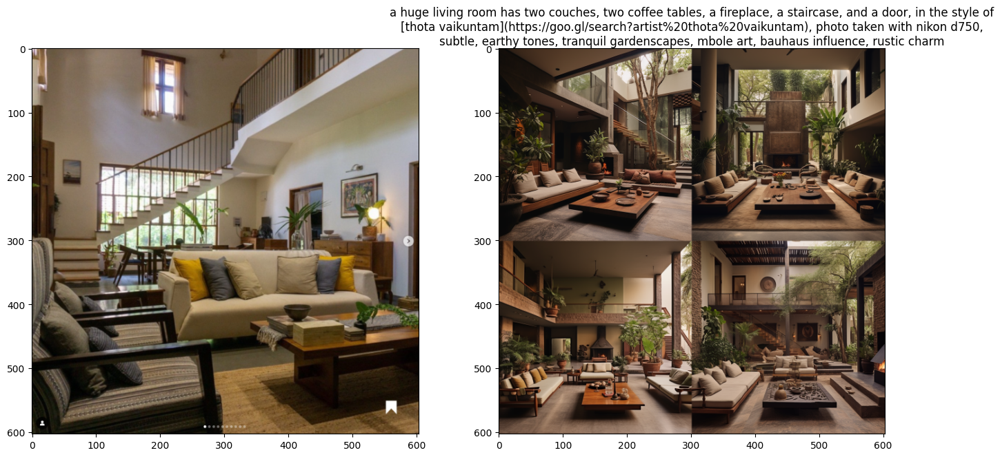

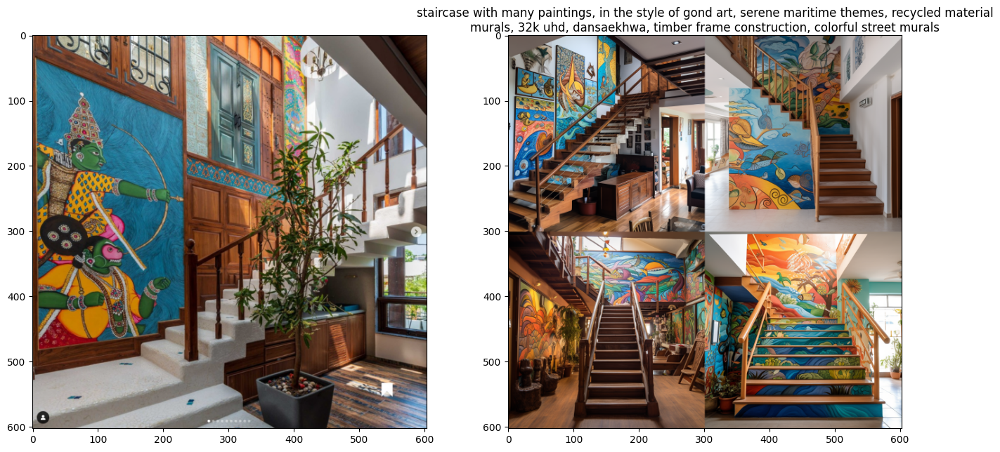

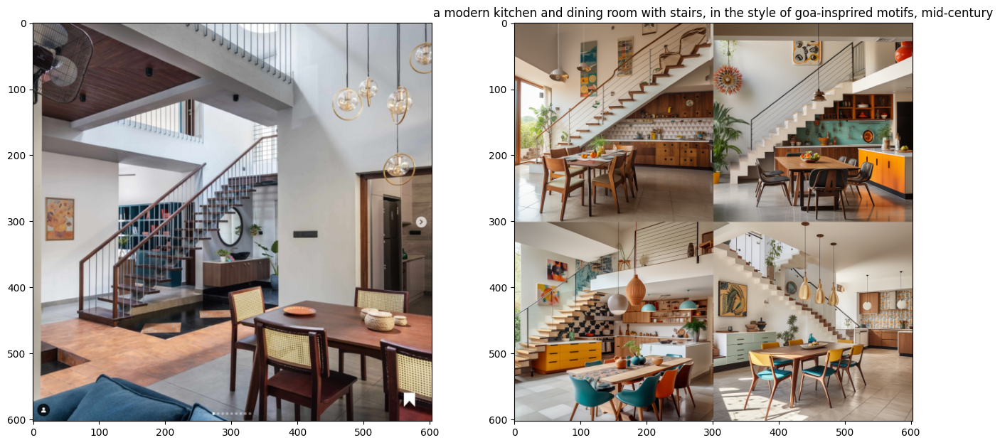

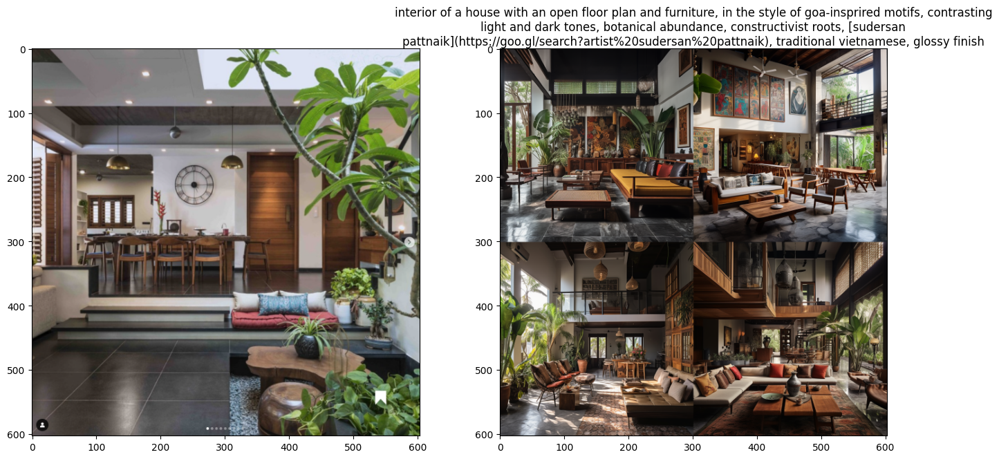

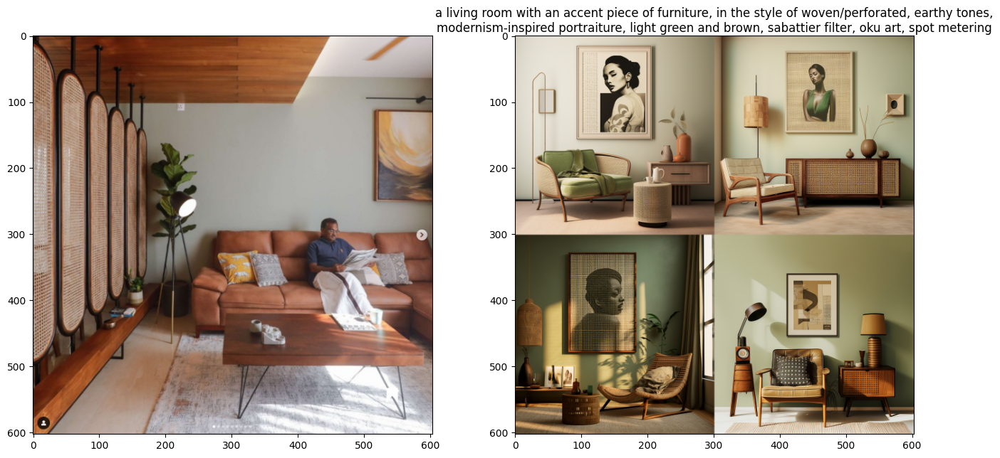

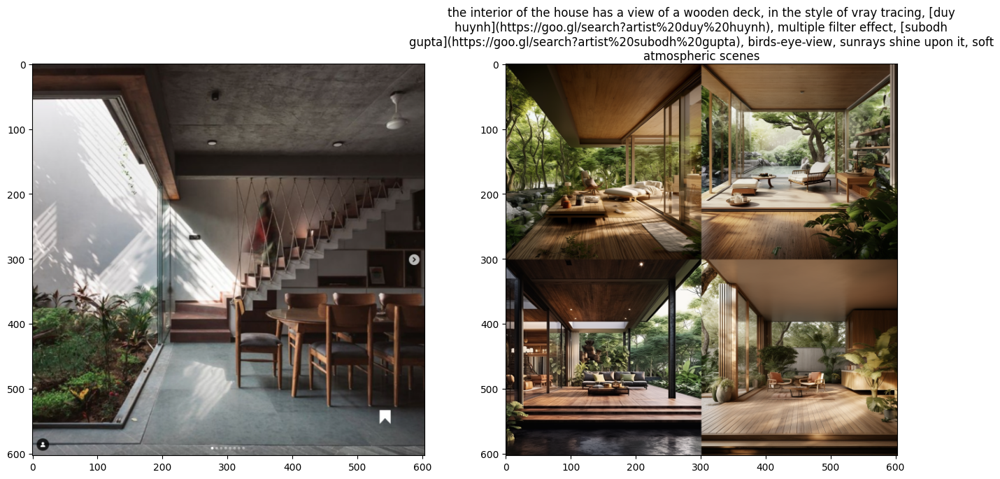

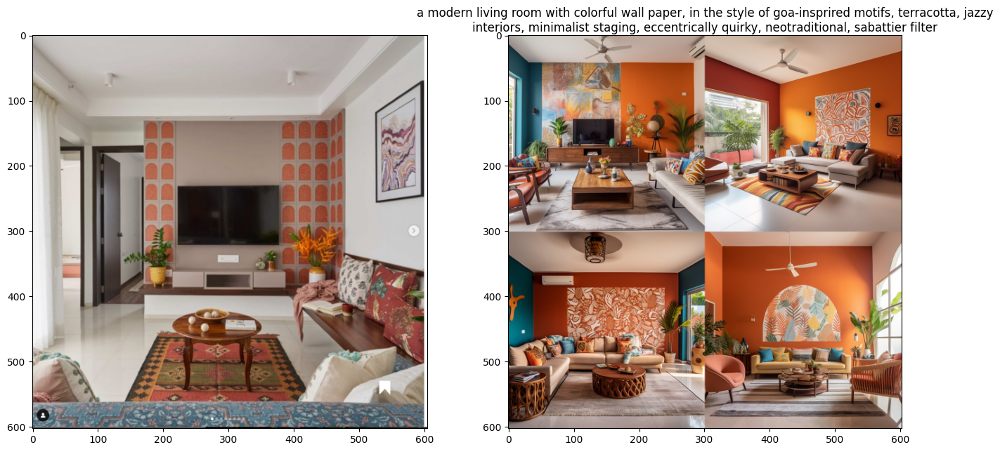

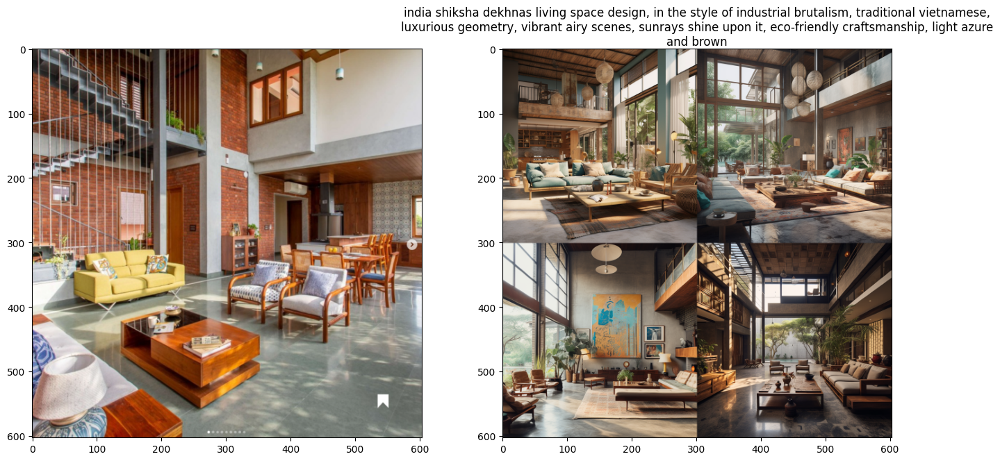

In [322]:
#Let's plot the original vs midjourney generated image for a single decor style, based on a certain instagram profile:
profile = 'volume-zero'
plot_imgComparison(profile, insta_profile_img_data)

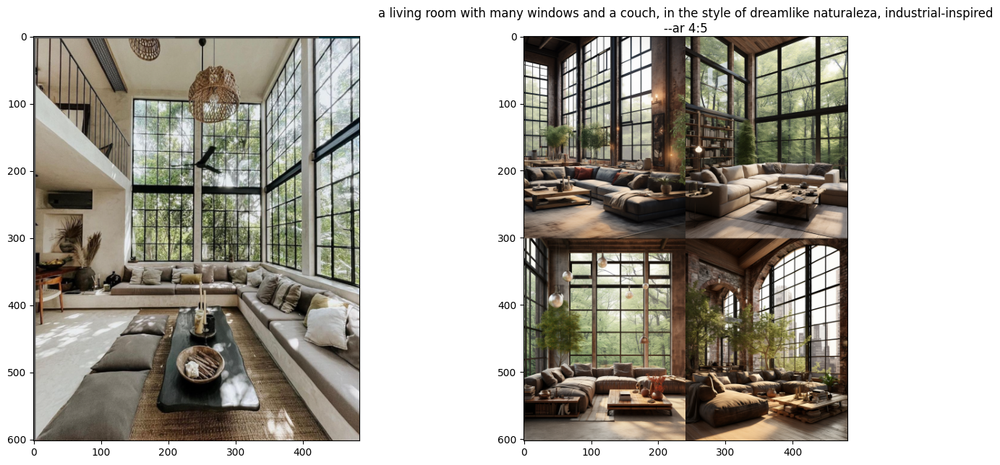

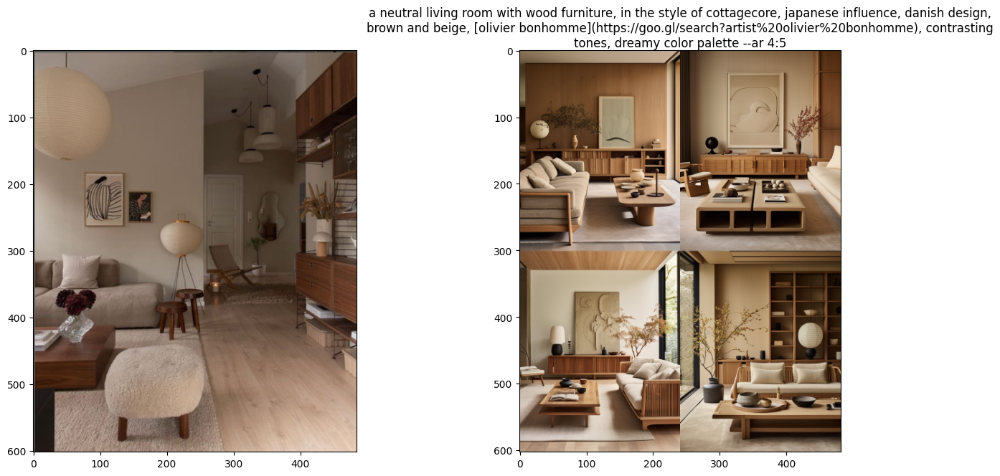

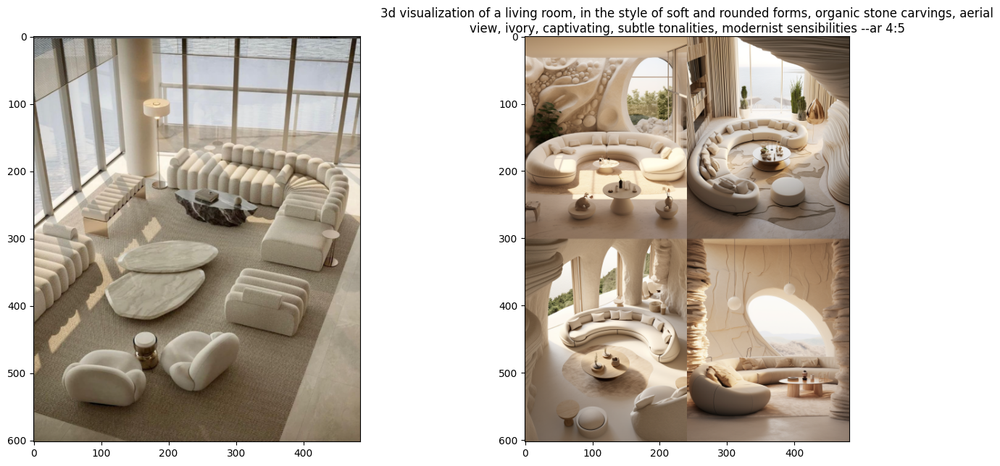

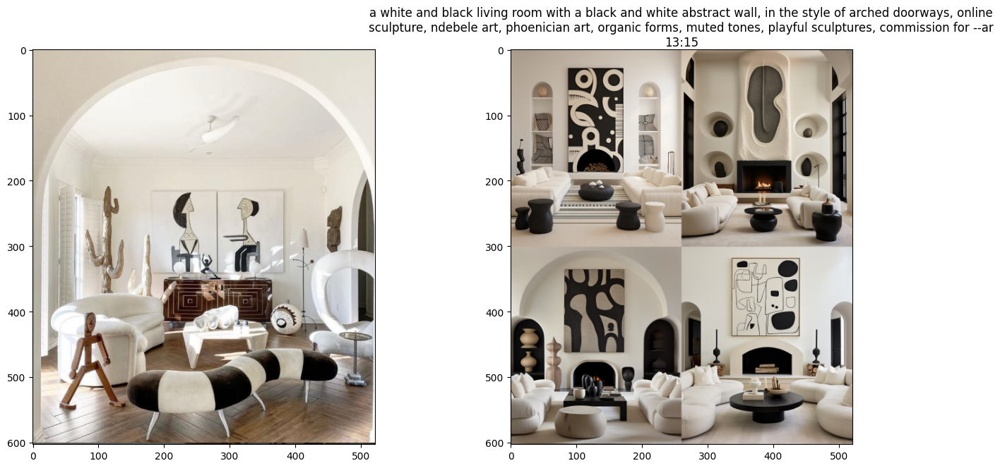

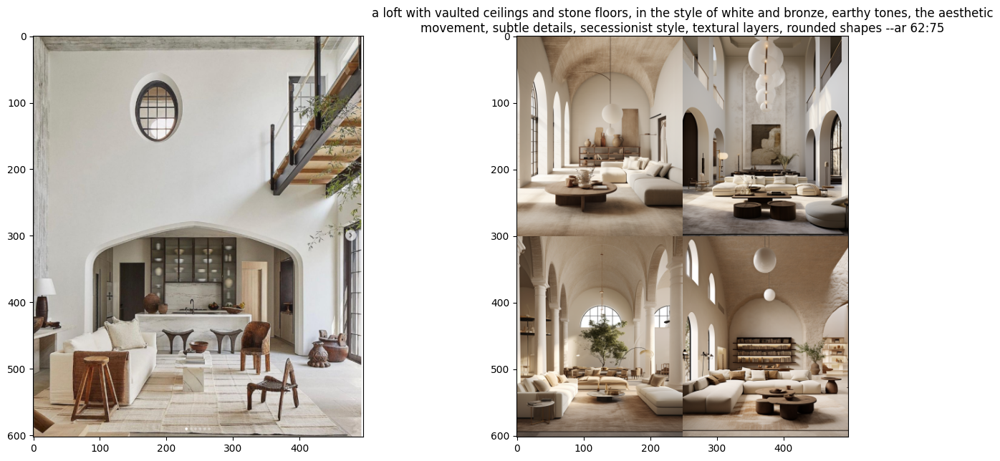

In [309]:
#Let's plot the original vs midjourney generated image for a single decor style, based on a certain instagram profile:
profile = 'lisaspollock'
plot_imgComparison(profile, insta_profile_img_data)

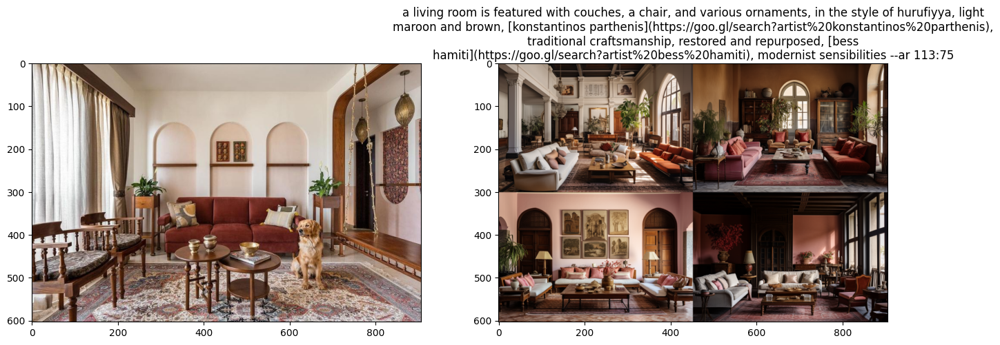

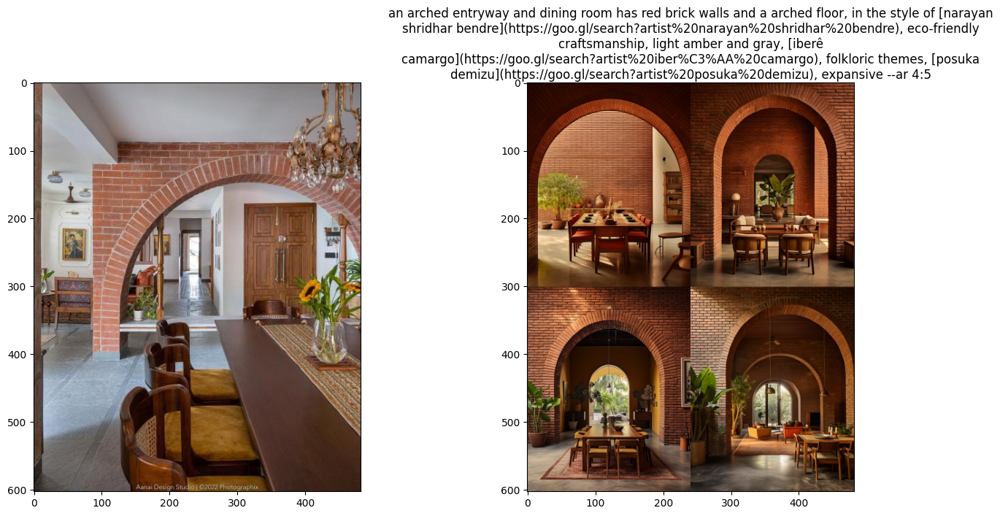

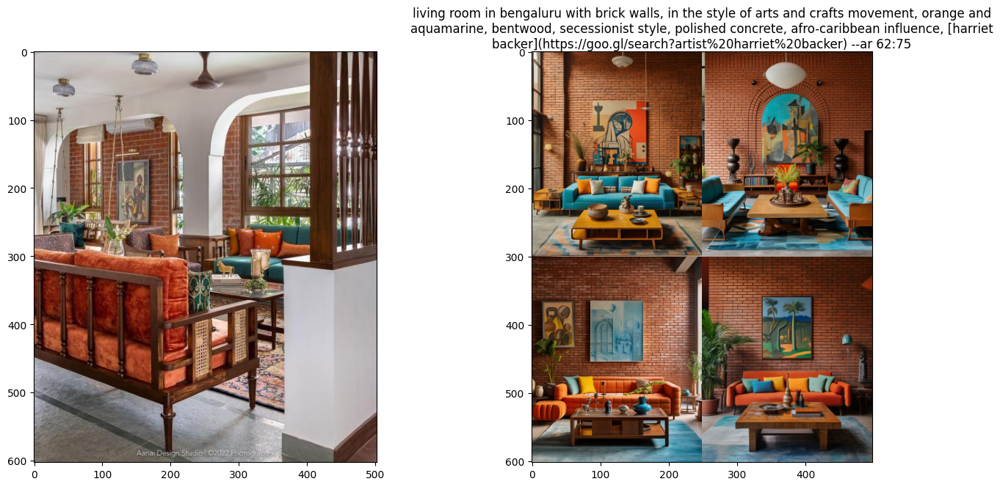

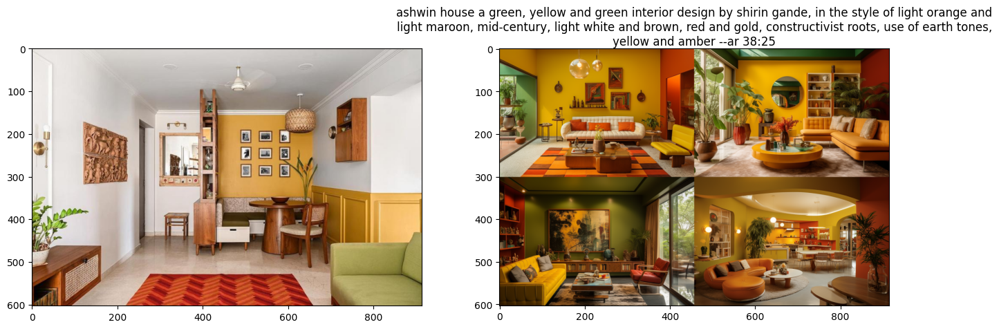

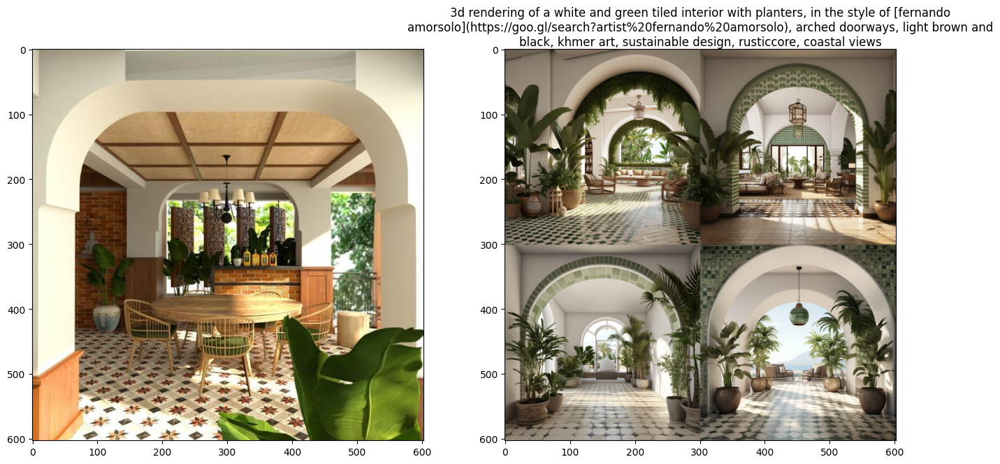

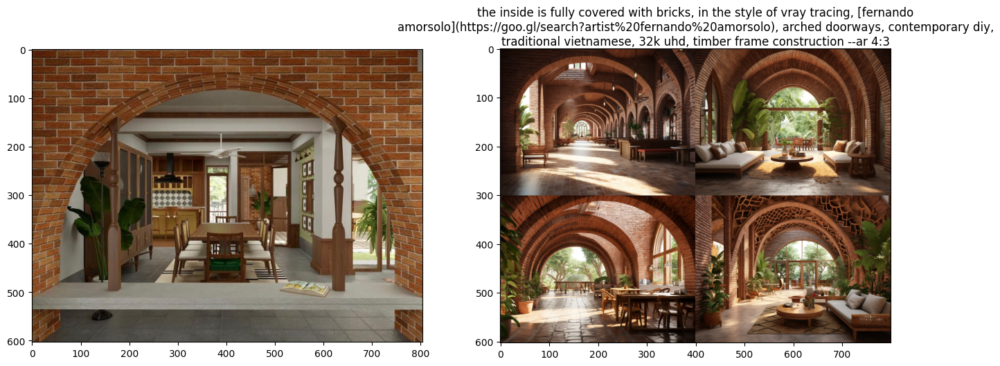

In [313]:
#Let's plot the original vs midjourney generated image for a single decor style, based on instagram profile:
profile = 'aanaistudio'
plot_imgComparison(profile, insta_profile_img_data)

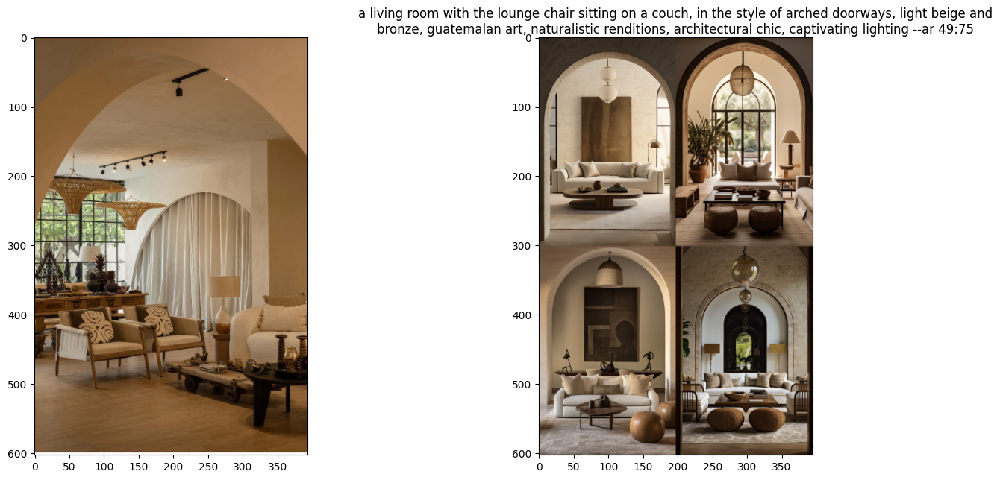

In [292]:
#Plot a random original image and its corresponging prompt with generated image
random_img = random.randint(0, 31)


if insta_profile_img_data.iloc[random_img]['generated_img_url'] is not np.nan:
    url = insta_profile_img_data.iloc[random_img]['generated_img_url']
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))

    org_url = insta_profile_img_data.iloc[random_img]['webhook_url']
    org_response = requests.get(org_url)
    org_img = Image.open(BytesIO(org_response.content))

    fig = plt.figure(figsize=(16,16))
    ax1 = fig.add_subplot(2,2,1)
    ax1.imshow(org_img)
    ax2 = fig.add_subplot(2,2,2)
    ax2.imshow(img)
    ax2.set_title(insta_profile_img_data.iloc[random_img]['prompt'], loc='center', wrap = True, fontsize = 12)
    plt.show()

### Evaluation:  Image comparison using clip's feature vectors:

The similarity between images can then be computed based on the cosine similarity or Euclidean distance of the original and midjourney generate image feature vectors.
<img src="notebook-images/evaluation_collab.png">
Note: Ran this on Collab. Torch issue on local machine

In [77]:
def generate_org_and_created_images(profile, data):
    for index in data.loc[data['profile'] == profile, 'generated_img_url'].index:
        if data.iloc[index]['generated_img_url'] is not np.nan:
            url = data.iloc[index]['generated_img_url']
            response = requests.get(url)
            img = Image.open(BytesIO(response.content))

            org_url = data.iloc[index]['webhook_url']
            org_response = requests.get(org_url)
            org_img = Image.open(BytesIO(org_response.content))
            return img, org_img
profile = 'aanaistudio'
o_img1, img1 = generate_org_and_created_images(profile, insta_profile_img_data)

In [3]:
'''
Ran this on Collab. Torch issue on local machine
'''
import torch
import open_clip
import cv2
from sentence_transformers import util
from PIL import Image
# image processing model
# device = "cuda" if torch.cuda.is_available() else "cpu"
model, _, preprocess = open_clip.create_model_and_transforms('ViT-B-16-plus-240', pretrained="laion400m_e32")
model.to(device)
def imageEncoder(img):
    img1 = Image.fromarray(img).convert('RGB')
    img1 = preprocess(img1).unsqueeze(0).to(device)
    img1 = model.encode_image(img1)
    return img1
def generateScore(image1, image2):
    test_img = cv2.imread(img1, cv2.IMREAD_UNCHANGED)
    data_img = cv2.imread(o_img1, cv2.IMREAD_UNCHANGED)
    img1 = imageEncoder(test_img)
    img2 = imageEncoder(data_img)
    cos_scores = util.pytorch_cos_sim(img1, img2)
    score = round(float(cos_scores[0][0])*100, 2)
    return score
print(f"similarity Score: ", round(generateScore(image1, image2), 2))
#similarity Score:  75.42

## StableDiffusion
### Let's try running a stableDiffusion model using the prompts we generated to compare results.

In [325]:
from diffusers import StableDiffusionPipeline, DPMSolverMultistepScheduler
import torch

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16, use_safetensors=True)

pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

pipe.to("cuda")


Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
def sd_generate(prompt: str):

    image_store = io.BytesIO()

    images = pipe(prompt).images

    images[0].save(image_store, "PNG")

In [28]:
prompt = 'a living room with an accent piece of furniture, in the style of woven/perforated, earthy tones, modernism-inspired portraiture, light green and brown, sabattier filter, oku art, spot metering'
sd_generate(prompt)

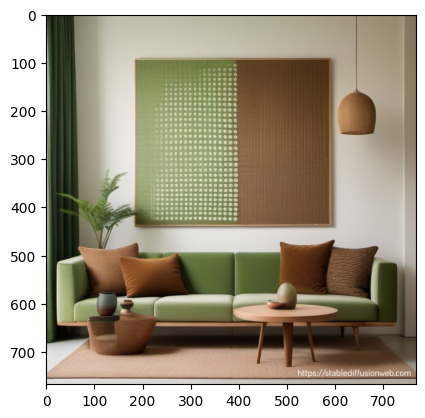

In [29]:
# Read Images
img = mpimg.imread('download.png')
 
# Output Images
plt.imshow(img)

#not bad, but it doesnt come close to midjourney results. Playing with the input parameters would certainly help. 
#But with the local laptop resources, the image generation is very slow (1 minute approximately) and then it terminates.

In [5]:
insta_profile_img_data = pd.read_csv('midjourney-img-links.csv')

In [61]:
#Let's generate some new prompts using the prompts generated, with chatgpt
import openai
from datetime import datetime, timedelta

prompts = []
for i in insta_profile_img_data['prompt']:
    if i != '':
        prompts.append(i)

# Load your API key        
openai.api_key = #ur key

def generate_prompts(prompts):
    gen_prompts = []

    for index, row in insta_profile_img_data.iterrows():
        if row["prompt"] != '':
            p = row["prompt"]

        prompt = (
            f"You are an expert with interior decor styles. "
            f"Read the following information about a interior decor description : '{p}'. "
            f"Generate 5 similar or better interior decor description"
            #f"Generate a similar or better interior decor description"
        )
        
        #gpt-3.5-turbo
        #text-davinci-002
        res = openai.Completion.create( engine="text-davinci-002",
        prompt=prompt,
        max_tokens=50,
        n=1,
        stop=None)
        gen_prompts.append(res["choices"][0]["text"])

    return gen_prompts

In [62]:
gpt_prompts = generate_prompts(prompts)

In [69]:
gpt_prompts[12]

' :\n\nThis is a 3d visualization of a living room with soft, rounded forms and organic stone carvings. The aerial view is ivory, captivating, and subtle. The modernist sensibilities are evident in the clean lines and uncl'

In [65]:
'''Overview of the prompts generated from chatgpt, created new prompts from exisitng ones, 
that are very similar to the original ideas.
Store the results for reference, and to send /imagine requests to midjourney
'''
# temp = pd.DataFrame(gpt_prompts)
# temp.to_csv('gptPrompts.csv')
gpt_prompts

[' based on the information given\n\nThis beautiful living room has two couches, two coffee tables, a fireplace, a staircase, and a door, all in the elegant Thota Vaikuntam style. The room has subtle earthy tones,',
 '.\n\nThis staircase features many beautiful paintings in the style of Gond art. The serene maritime themes and recycled material murals add a unique and colorful touch to the space. The timber frame construction and street murals contribute to the overall atmosphere',
 '.\n\nThis kitchen and dining room combination is designed with modern and Goa-inspired motifs in mind. The stairs are a beautiful mid-century touch that add to the overall aesthetic of the space.',
 ' using your own words.\n\n\n\nThis room has a light and airy feel, with plenty of botanical inspiration in the form of goa-inspired motifs. The dark furniture provides a nice contrast, while the constructivist roots add a',
 '.\n\n\n\nThis is a living room with an accent piece of furniture in the style of wove

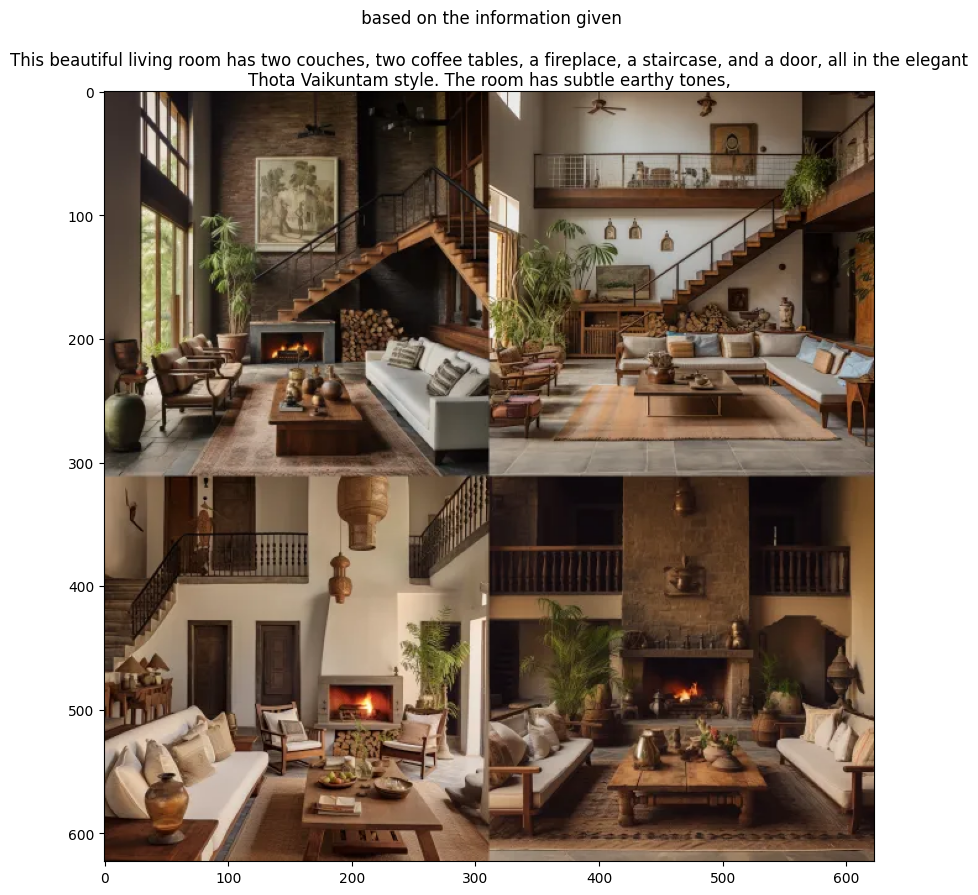

In [70]:
'''Let's evaluate with one of these prompts:
'''
# response = send_imagine_request(gpt_prompts[0])
url = 'https://media.discordapp.net/attachments/1171880746399584388/1176716201511096330/puppalasa_A_rustic_and_charming_living_room_with_two_couches_tw_c912b141-284b-4c37-a8a1-c7406c86df57.png?ex=656fe15c&is=655d6c5c&hm=c9722340fce7aa891bef9d6380d97608c262d771b5c40398e7120f890b1bbb06&=&format=webp&width=623&height=623'
response = requests.get(url)
img = Image.open(BytesIO(response.content))

response = requests.get(url)
org_img = Image.open(BytesIO(response.content))

fig = plt.figure(figsize=(10,10))
ax1 = fig.add_subplot(1,1,1)
ax1.imshow(org_img)

ax1.set_title(gpt_prompts[0], loc='center', wrap = True, fontsize = 12)
plt.show()

### That looks pretty amazing. 

#### Closing thoughts

These images and prompts generated so far are assumed to be created for clients/people who might have ideas similar to what we have in mind. This can be further expanded given that we have the resources.

The images generated using these prompts can be used to further experiment using generative models like clip, stable diffusion to create further ideas and expand on the current ones, to a varied set of styles. Given that we have the computational resources, these can be used to train models to textually search for a particular style in a feature space and generate a personalized representation of what the clientele might be looking for.